In [1]:
import pyarrow.dataset as ds
from pyarrow import fs
import matplotlib.pyplot as plt
import datetime as dt
import pandas as pd

s3 = fs.S3FileSystem(endpoint_override = "data.ecoforecast.org", anonymous = True)
dataset = ds.dataset("neon4cast-drivers/noaa/gefs-v12/stage2/parquet",
                     format = "parquet",
                     filesystem=s3,
                     partitioning=["start_date", "cycle"]
                    )
expression = ((ds.field("start_date") == "2021-08-23") &
              (ds.field("cycle") == 00)
             )
ex = dataset.to_table(filter=expression)
ex = ex.to_pandas()
ex['formatted_times'] = pd.to_datetime(ex['time'].values).tz_localize(None)
ex = ex.set_index(['formatted_times', 'ensemble', 'site_id', 'start_time', 'horizon'])

In [2]:
s3 = fs.S3FileSystem(endpoint_override = "data.ecoforecast.org", anonymous = True)
dataset = ds.dataset(
    "neon4cast-drivers/noaa/gefs-v12/stage3/parquet",
    format = "parquet",
    filesystem=s3,
)
ex3 = dataset.to_table()
ex3 = ex3.to_pandas()
ex3['formatted_times'] = pd.to_datetime(ex3['time'].values).tz_localize(None)
ex3 = ex3.set_index(['formatted_times', 'site_id', 'ensemble'])

In [3]:
ex_pivot = ex.pivot(columns = 'variable', values = 'predicted')
ex3_pivot = ex3.pivot(columns = 'variable', values = 'predicted')

In [4]:
ensemble_max3 = ex3_pivot.groupby([ex3_pivot.index.get_level_values(0), 
                                  ex3_pivot.index.get_level_values(1)]).max()
ensemble_min3 = ex3_pivot.groupby([ex3_pivot.index.get_level_values(0), 
                                  ex3_pivot.index.get_level_values(1)]).min()
ensemble_mean3 = ex3_pivot.groupby([ex3_pivot.index.get_level_values(0), 
                                  ex3_pivot.index.get_level_values(1)]).mean()
ensemble_stdv3 = ex3_pivot.groupby([ex3_pivot.index.get_level_values(0), 
                                  ex3_pivot.index.get_level_values(1)]).std()

In [5]:
ensemble_max = ex_pivot.groupby([ex_pivot.index.get_level_values(0), 
                                  ex_pivot.index.get_level_values(2), 
                                  ex_pivot.index.get_level_values(3), 
                                  ex_pivot.index.get_level_values(4)]).max()
ensemble_min = ex_pivot.groupby([ex_pivot.index.get_level_values(0), 
                                  ex_pivot.index.get_level_values(2), 
                                  ex_pivot.index.get_level_values(3), 
                                  ex_pivot.index.get_level_values(4)]).min()
ensemble_mean = ex_pivot.groupby([ex_pivot.index.get_level_values(0), 
                                  ex_pivot.index.get_level_values(2), 
                                  ex_pivot.index.get_level_values(3), 
                                  ex_pivot.index.get_level_values(4)]).mean()
ensemble_stdv = ex_pivot.groupby([ex_pivot.index.get_level_values(0), 
                                  ex_pivot.index.get_level_values(2), 
                                  ex_pivot.index.get_level_values(3), 
                                  ex_pivot.index.get_level_values(4)]).std()

In [6]:
ensemble_mean3 = ensemble_mean3[(ensemble_mean3.index.get_level_values(0) >= ensemble_mean.index.get_level_values(0)[0]) & 
                                (ensemble_mean3.index.get_level_values(0) <= ensemble_mean.index.get_level_values(0)[-1])]

## When are the ensembles agreeing and disagreeing the most at each station?

In [7]:
ex.variable.unique()

array(['surface_downwelling_longwave_flux_in_air',
       'surface_downwelling_shortwave_flux_in_air', 'precipitation_flux',
       'air_pressure', 'relative_humidity', 'air_temperature',
       'northward_wind', 'eastward_wind'], dtype=object)

/var/folders/21/bhksj_cn7zz43y8x0m4gsh0h0000gn/T/ipykernel_5702/2659417759.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,5))


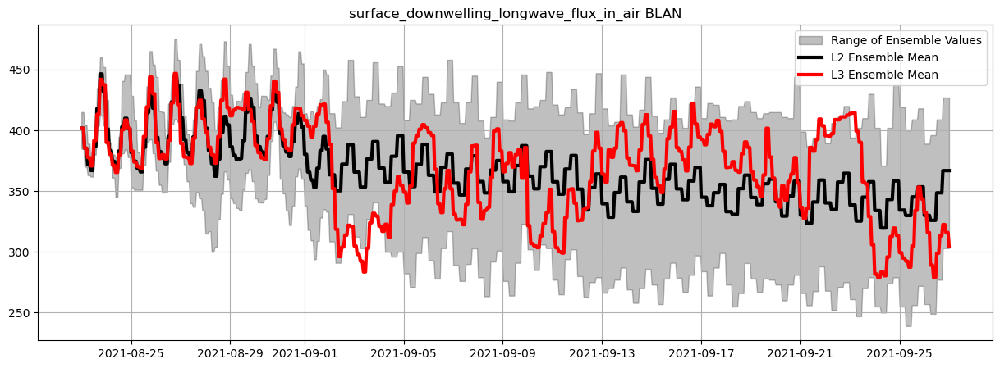

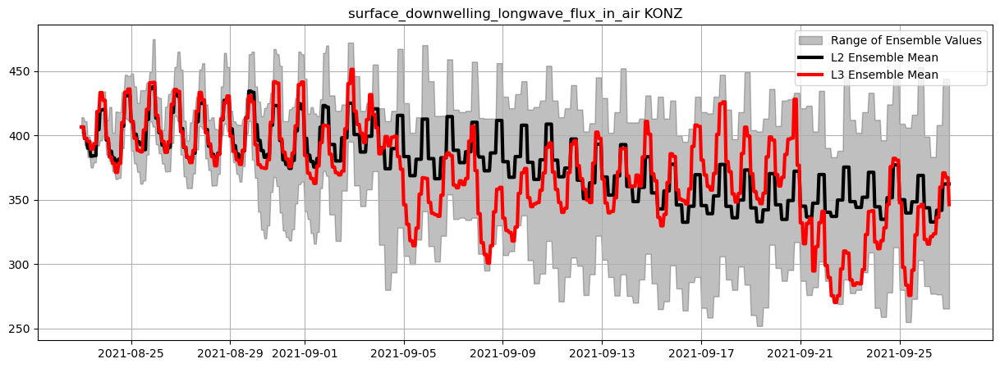

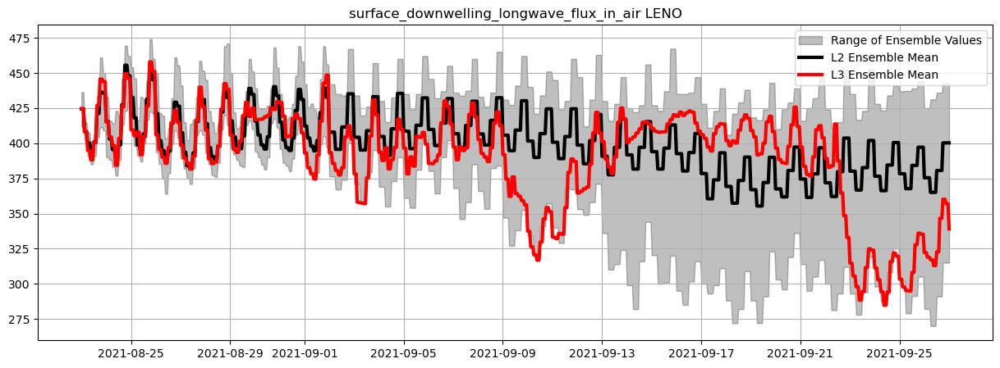

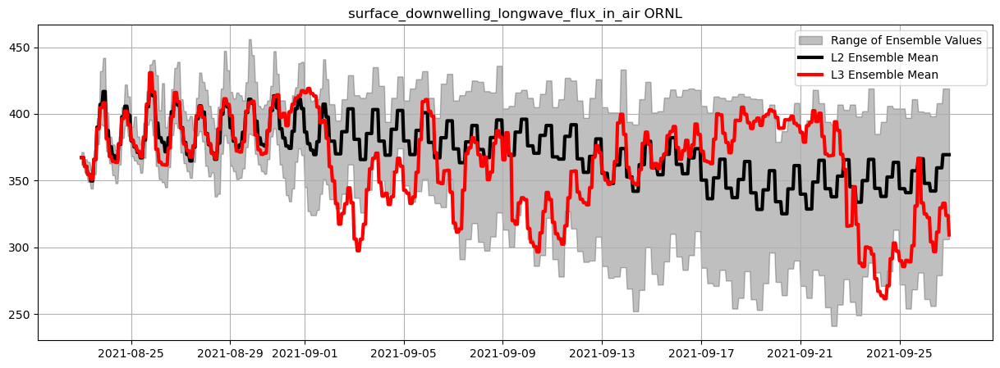

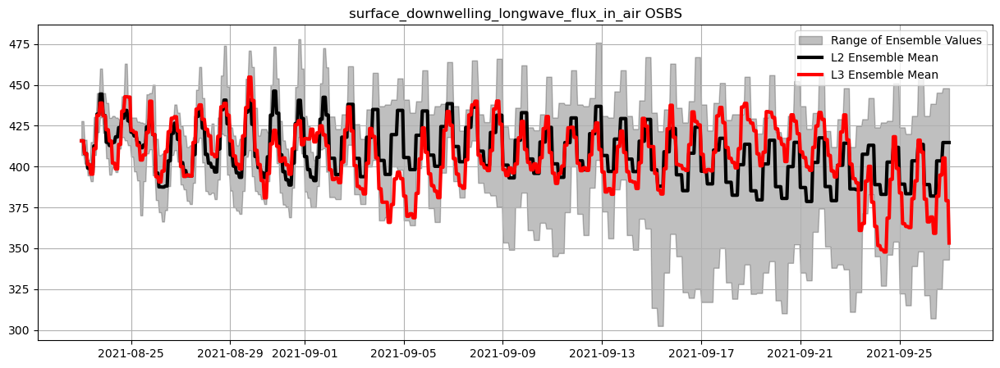

...

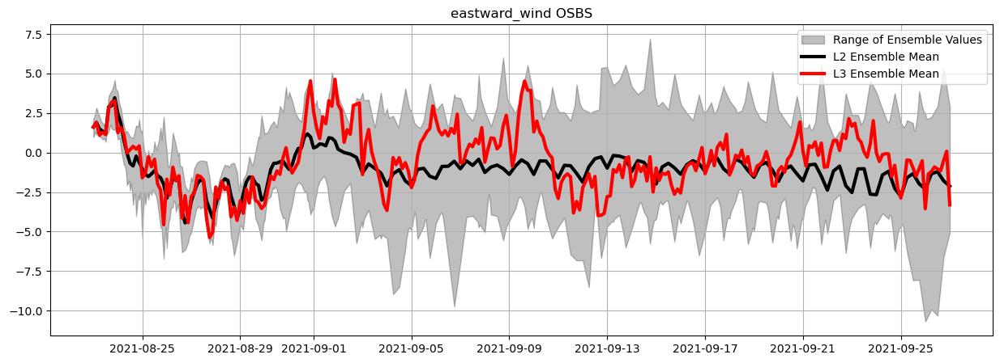

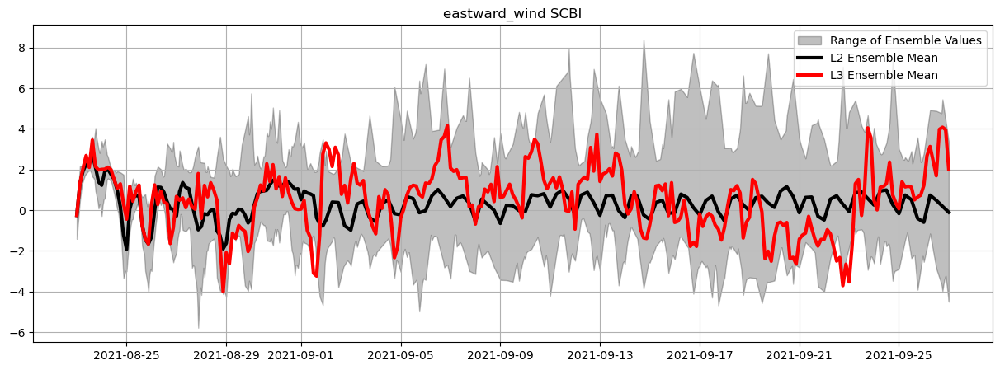

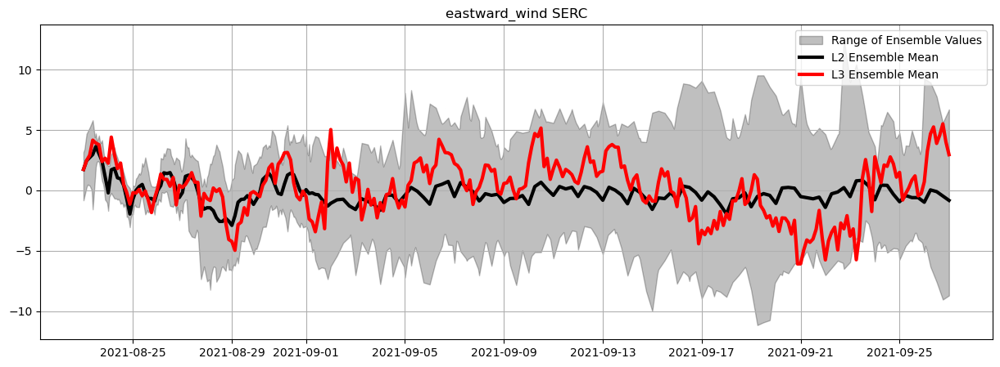

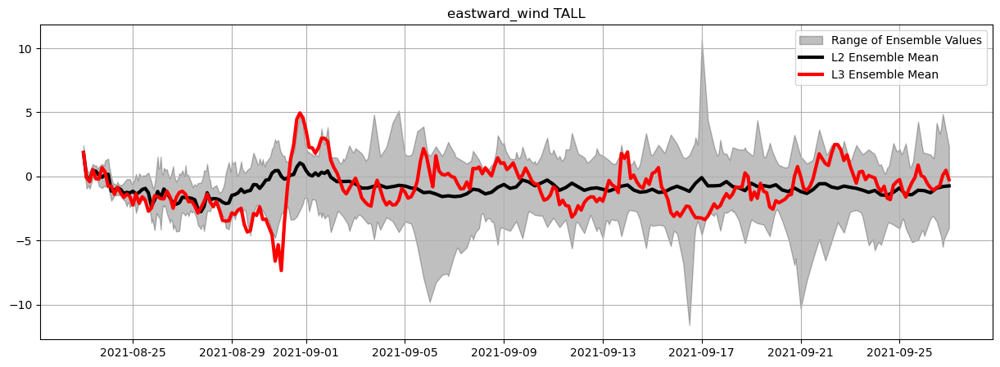

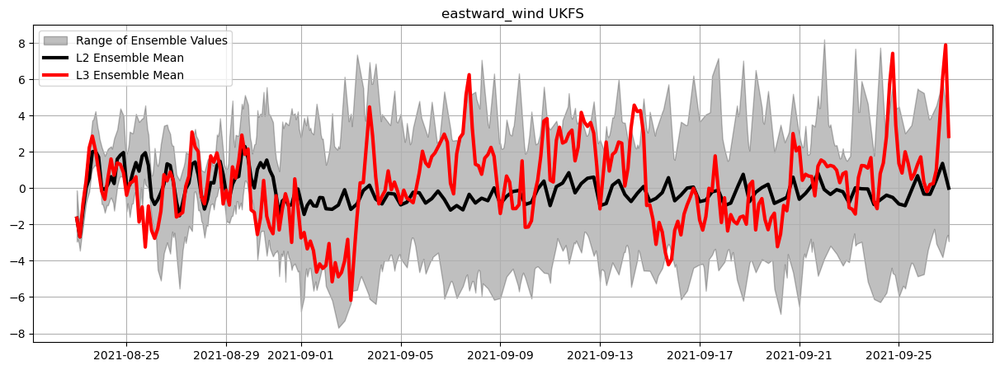

In [9]:
sites = ["BLAN", "KONZ", "LENO", "ORNL", "OSBS", "SCBI",
               "SERC", "TALL", "UKFS"]
ensembles = ex_pivot.index.get_level_values(1).unique()
start_time = ex_pivot.index.get_level_values(3).unique()[0]
horiz = ex_pivot.index.get_level_values(4).unique()[0]
var = 'air_temperature'

for var in ex.variable.unique():
    for site in sites:
        plt.figure(figsize = (15,5))
        plt.fill_between(ensemble_max[(ensemble_max.index.get_level_values(1) == site)].index.get_level_values(0), 
                 (ensemble_max[(ensemble_max.index.get_level_values(1) == site)][var]),
                (ensemble_min[(ensemble_min.index.get_level_values(1) == site)][var]), alpha = 0.25, color = 'k')
        plt.plot(ensemble_mean[(ensemble_mean.index.get_level_values(1) == site)].index.get_level_values(0),
                 ensemble_mean[(ensemble_mean.index.get_level_values(1) == site)][var], color = 'k', linewidth = '3')
        plt.plot(ensemble_mean3[(ensemble_mean3.index.get_level_values(1) == site)].index.get_level_values(0),
                 ensemble_mean3[(ensemble_mean3.index.get_level_values(1) == site)][var], color = 'r', linewidth = '3')
        plt.grid()
        plt.title(var + ' ' + site)
        plt.legend(['Range of Ensemble Values', 'L2 Ensemble Mean', 'L3 Ensemble Mean'])
        plt.savefig('figs/' + var + '_' + site + '.png')

/var/folders/21/bhksj_cn7zz43y8x0m4gsh0h0000gn/T/ipykernel_5702/1875987122.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,5))


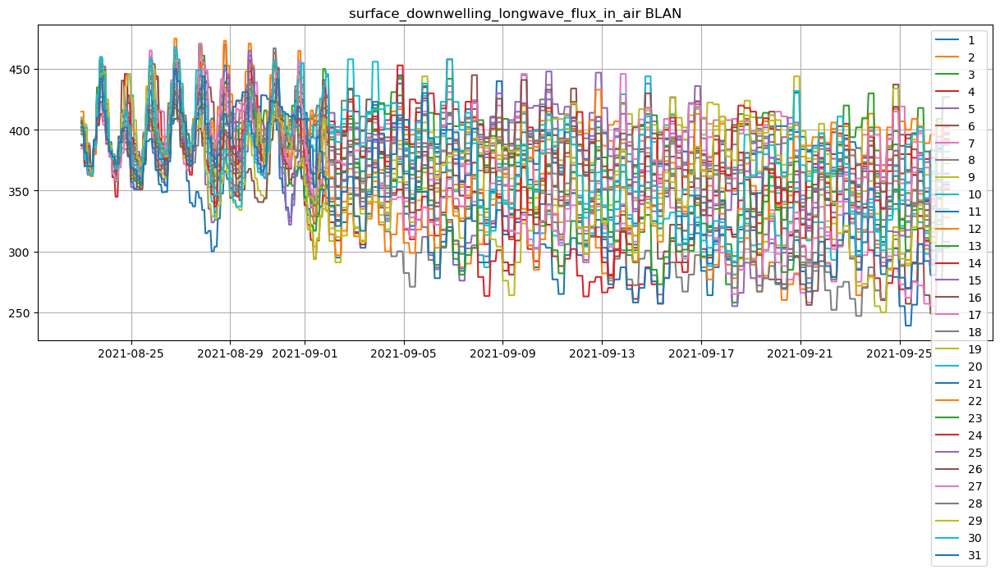

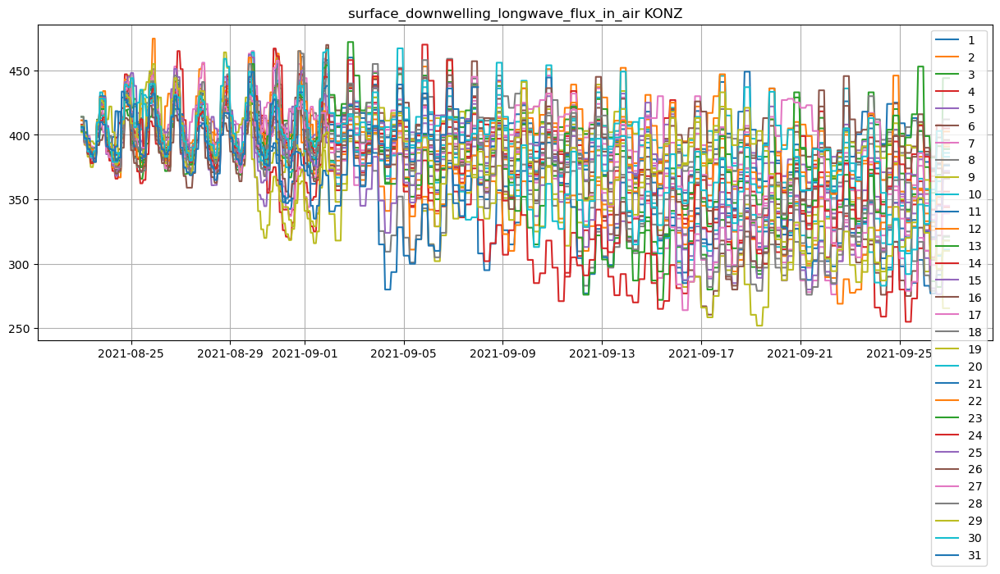

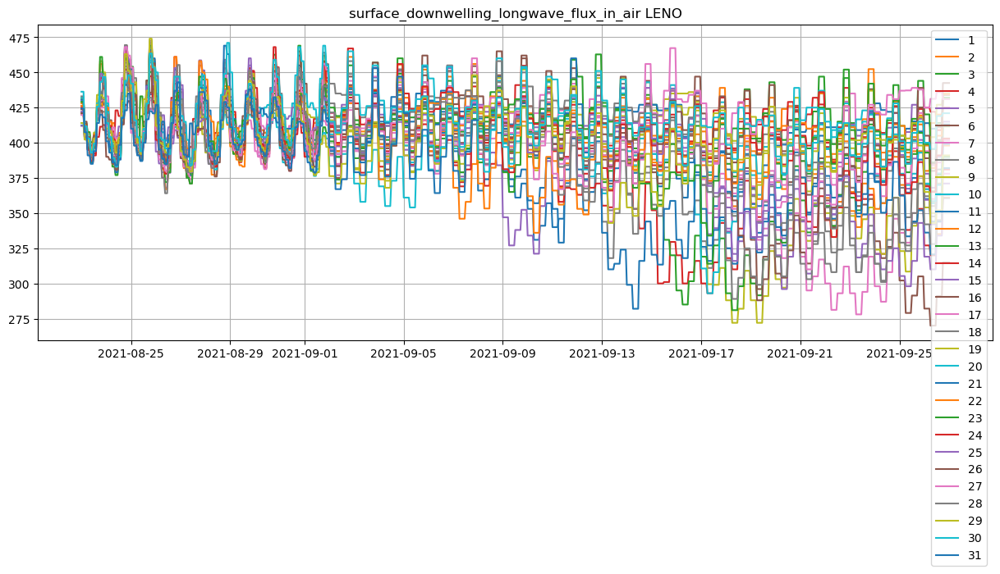

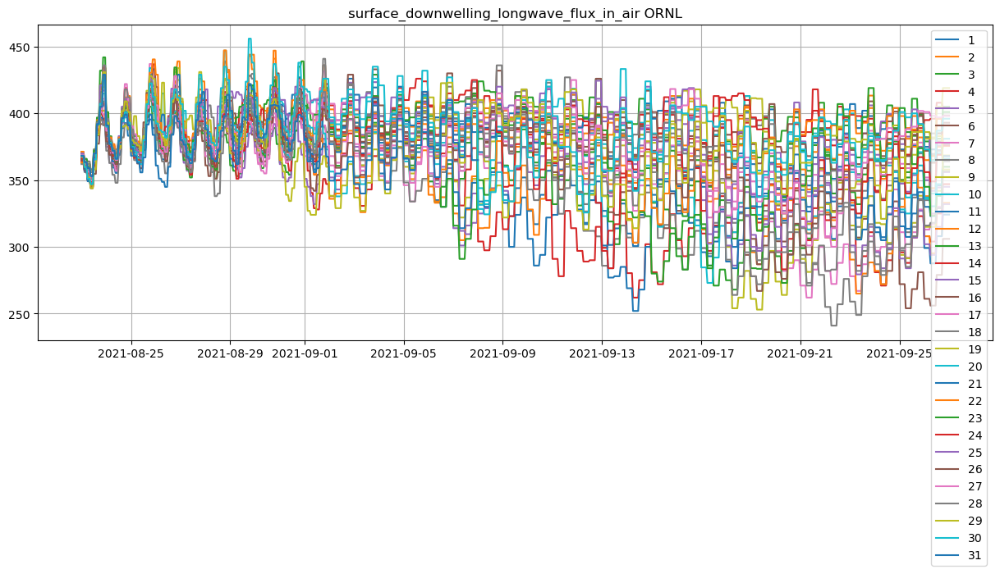

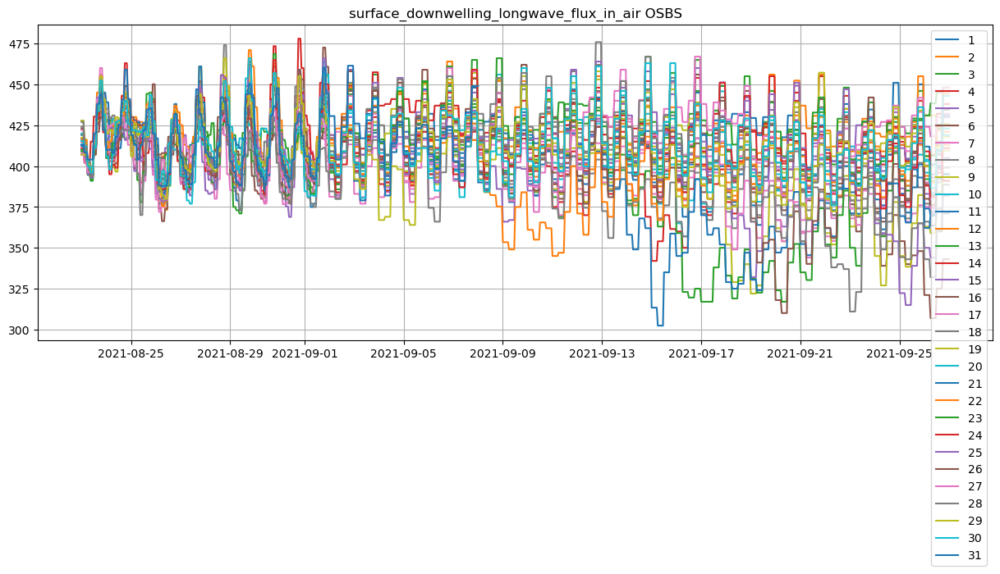

...

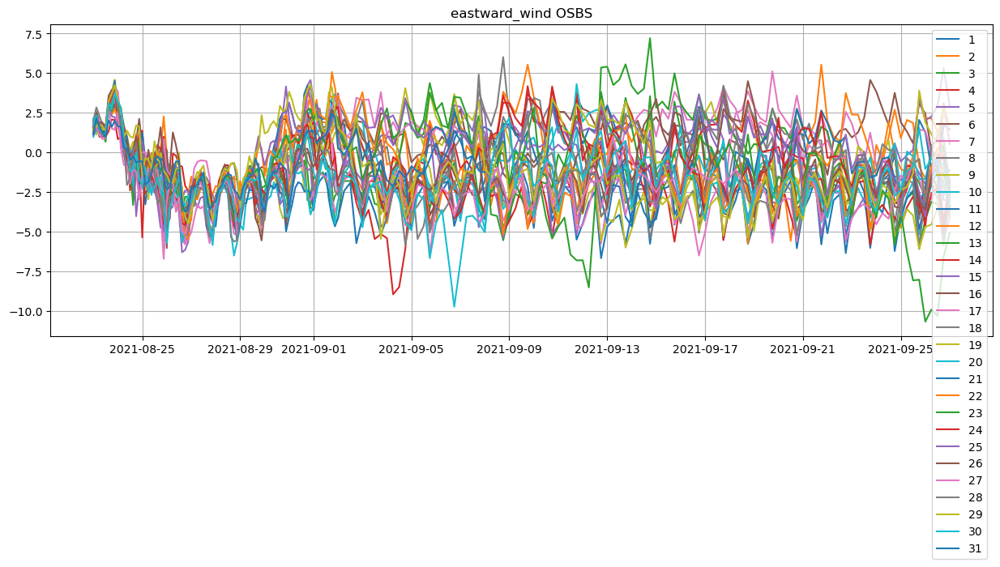

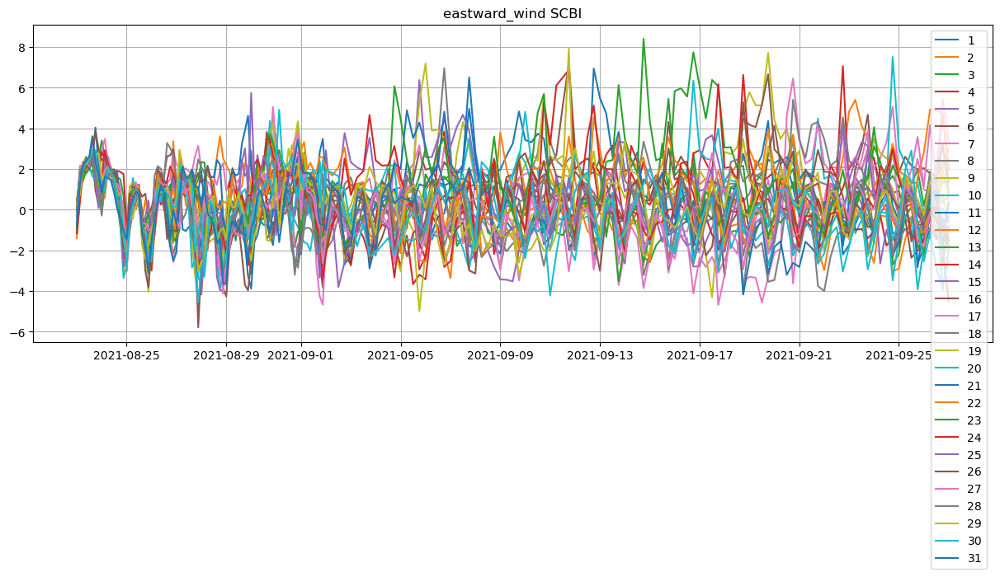

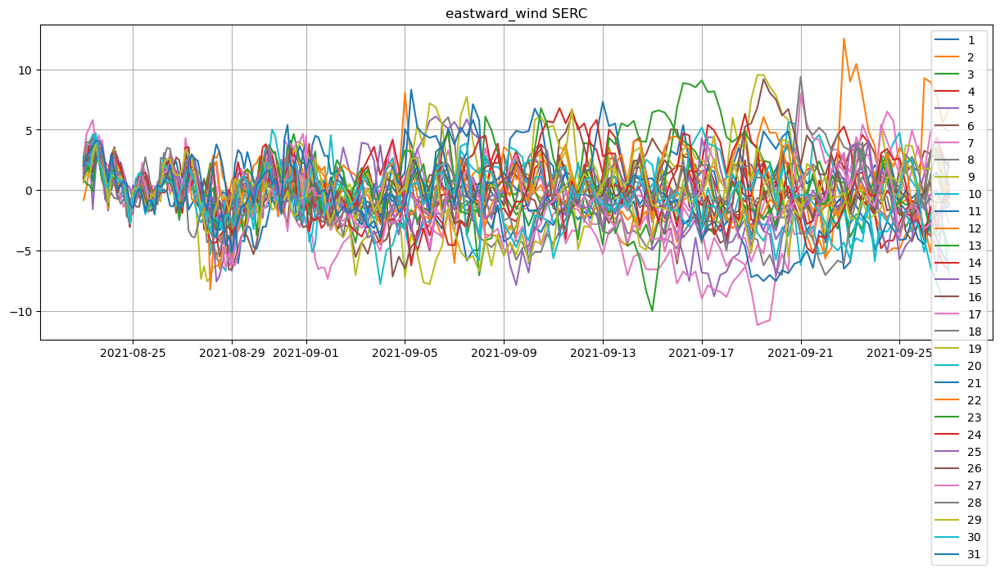

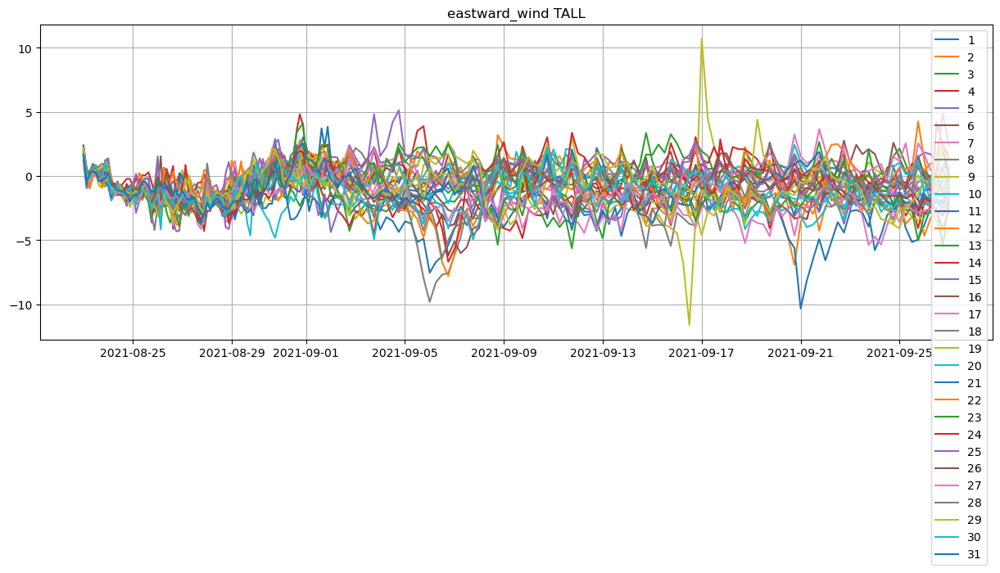

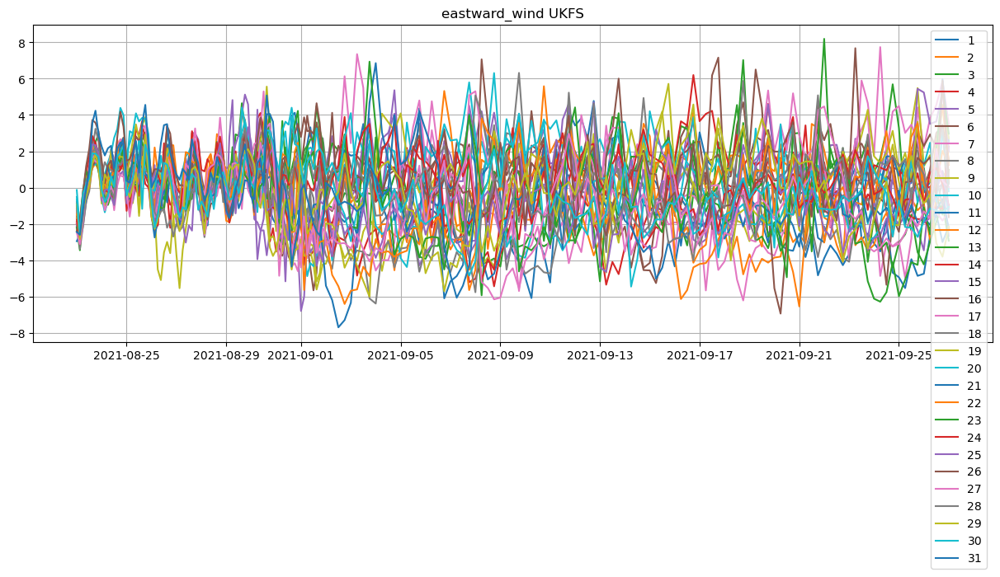

In [10]:
ensembles = ex_pivot.index.get_level_values(1).unique()
start_time = ex_pivot.index.get_level_values(3).unique()[0]
horiz = ex_pivot.index.get_level_values(4).unique()[0]

for var in ex.variable.unique():
    for site in sites:
        plt.figure(figsize = (15,5))
        for ensemble in ensembles:
            plt.plot(ex_pivot[(ex_pivot.index.get_level_values(2) == site) &
                             (ex_pivot.index.get_level_values(1) == ensemble)].index.get_level_values(0), 
                     ex_pivot[(ex_pivot.index.get_level_values(2) == site) &
                             (ex_pivot.index.get_level_values(1) == ensemble)][var], label = ensemble)
        plt.grid()
        plt.title(var + ' ' + site)
        plt.legend()
        plt.savefig('figs/ensemble/' + var + '_' + site + '.png')